In [1]:
import numpy as np
import scipy as sp
import pickle
import utilities as u
import preprocessing as pp
import SimulatedSimMats as ssm
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import UnityTransforms as ut
import SimilarityMatrixAnalysis as sm
import os

%matplotlib inline

%load_ext autoreload
%autoreload 2

In [2]:
with open("D:\\Morph_Results\\rare_sf_regression.pkl",'rb') as f:
    rare_sfreg = pickle.load(f)
    
with open("D:\\Morph_Results\\freq_sf_regression.pkl",'rb') as f:
    freq_sfreg = pickle.load(f)

In [3]:
print(rare_sfreg.keys())

dict_keys(['4139265.3', '4139265.4', '4139265.5', '4222168.1', '4343703.1', '4343706'])


In [4]:
def mean_prior_post(dict_sfreg,sigma_likelihood=.3,x=np.linspace(-.1,1.1,num=1000)[np.newaxis,:]):
    mice = [mouse for mouse in dict_sfreg.keys()]
    priors = np.zeros([len(mice),x.shape[1]])
    for i, (mouse,res) in enumerate(dict_sfreg.items()):
        _prior=None
        for _p in res['priors']:
            if _prior is None:
                _prior = _p
            else:
                _prior+=_p
        _prior = _prior/_prior.sum()
        priors[i,:]=_prior
        
    prior = _prior.mean(axis=0,keepdims=True)
    prior = prior/prior.sum()
    post = prior*u.gaussian(np.linspace(-.3,1.3,num=1000)[:,np.newaxis],sigma_likelihood,np.linspace(-.3,1.3,num=1000)[np.newaxis,:])
    post = post/post.sum(axis=1)
    return priors, prior, post
rare_priors,rare_prior,rare_post = mean_prior_post(rare_sfreg)
freq_priors,freq_prior,freq_post = mean_prior_post(freq_sfreg)
xx = np.linspace(-.3,1.3,num=1000)[np.newaxis,:]
rare_spline = ssm.make_sampling_spline(xx.ravel(),rare_prior)
freq_spline = ssm.make_sampling_spline(xx.ravel(),freq_prior)


In [5]:
def single_cell_model(log_cumprior_spline,d):
    '''
    implement hebbian learning for a single cell with inputs that are RBFs for some stimulus
    inputs: log_cumprior_spline - numpy univariate spline for sampling from the cumulative prior
            d - dictionary of parameters
    returns: w - weights of learned model
            yy - activity of cell
    '''
    
    ### INITIALIZATIONS
    THETA = np.linspace(-.3,1.3,num=d['nInputs']) 
    if d['alpha'] is None:
        d['alpha']=1/d['nInputs']
        
        
    w = np.random.rand(d['nInputs']) # uniformly distributed random small weights
    
   
    samples = log_cumprior_spline(np.random.rand(d['nSamples'])) # sample from prior
    ### LEARNING
    for i,s in enumerate(samples.tolist()):
        # generate inputs from those samples
#         x =u.gaussian(THETA,d['sigma'],s+d['stim noise']*np.random.randn(1)) 
        x =np.random.poisson(u.gaussian(THETA,d['sigma'],s)) #+d['stim noise']*np.random.randn(1)) 
#         y=np.maximum(d['alpha']*np.dot(w,x) + d['act noise']*np.random.randn(1),0) # rectified activation of cell
        y = np.random.poisson(d['alpha']*np.dot(w,x))
        # update weights
        dw = d['eta']*x*y - d['tau'] #+ d['dW noise']*np.random.randn(w.shape[0])
        w+=dw 
        w=np.maximum(np.minimum(w,d['Wmax']),0) # rectify and clamp range of weights
        

    ### SAMPLE FROM LEARNED MODEL
    morph_theta = np.linspace(-.3,1.3,num=1000) # morph values to sample at
    yy = np.zeros(morph_theta.shape) # output 
    for i,s in enumerate(morph_theta.tolist()):
        # inputs
        x =u.gaussian(THETA,d['sigma'],s+d['stim noise']*np.random.randn(1)) 
        yy[i]=np.maximum(d['alpha']*np.dot(w,x) + d['act noise']*np.random.randn(1),0) # rectified activation of cell
    
    return w,yy,morph_theta,samples


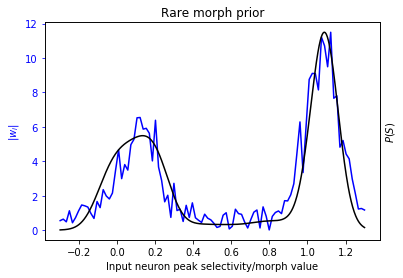

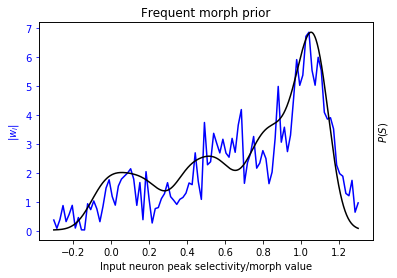

In [6]:
d_singlecell = {'stim noise': .05, # constant for sampling from standard Gaussian noise
    'nInputs': 100, # number of input neurons
    'nSamples':1000, # num training samples
    'alpha':.01, # constant to apply to output, defaults to 1/nInputs
    'eta': .1, # learning rate, results are somewhat sensitive to this value
    'sigma': .1, # width of radial basis functions
    'act noise':.0, # noise to apply to output
    'dW noise': 0.00, # constant to apply to weight update noise 
    'tau': .0000, # forgetting rate
    'Wmax':np.inf } # maximum value of weight

# rare morph prior
w,y,morph_theta,samples = single_cell_model(rare_spline,d_singlecell)

f,ax = plt.subplots()

ax.plot(np.linspace(-.3,1.3,num=w.shape[0]),w,color='blue')
ax.set_ylabel('$\|w_i\|$')
ax.yaxis.label.set_color('blue')
ax.tick_params(axis='y', colors='blue')
ax_dense = ax.twinx()
ax_dense.plot(np.linspace(-.3,1.3,num=rare_prior.shape[1]),rare_prior.ravel(),color='black',label='Prior Density')
ax_dense.set_ylabel('$P(S)$')
ax_dense.set_yticks([])
ax.set_xlabel('Input neuron peak selectivity/morph value')
ax.set_title("Rare morph prior")
f.savefig("D:\\Morph_Results\\figures\\KWTA\\single_cell_rare.pdf",format='pdf')



# frequent morph prior
w,y,morph_theta,samples = single_cell_model(freq_spline,d_singlecell)

f,ax = plt.subplots()
ax.plot(np.linspace(-.3,1.3,num=w.shape[0]),w,color='blue')
ax.set_ylabel('$\|w_i\|$')
ax.yaxis.label.set_color('blue')
ax.tick_params(axis='y', colors='blue')
ax_dense = ax.twinx()
ax_dense.plot(np.linspace(-.3,1.3,num=freq_prior.shape[1]),freq_prior.ravel(),color='black',label='Prior Density')
ax_dense.set_ylabel('$P(S)$')
ax_dense.set_yticks([])
ax.set_xlabel('Input neuron peak selectivity/morph value')
ax.set_title("Frequent morph prior")

f.savefig("D:\\Morph_Results\\figures\\KWTA\\single_cell_freq.pdf",format='pdf')


In [7]:
def kwta_network_model(log_cumprior_spline, d):
    
    ## INITIALIZATIONS
    THETA = np.linspace(-.1,1.1,num=d['nInputs']) 
    if d['alpha'] is None:
        d['alpha']=1/d['nInputs']
    W = .1*np.random.rand(d['nInputs'],d['n_neurons']) # weight matrix
    k = int(d['n_neurons']*d['wta_k']) # number of winners
    
    
    #draw samples for learning
    samples = log_cumprior_spline(np.random.rand(d['nSamples']))
    
    
    ## LEARNING
    for i,s in enumerate(samples.tolist()):
        # inputs
        x =u.gaussian(THETA,d['sigma'],s+d['stim noise']*np.random.randn(1)) 
#         x = np.random.gamma(u.gaussian(THETA,d['sigma'],s))
        # activation of each cell
        act = np.matmul(W.T,x)+ d['act noise']*np.random.randn(d['n_neurons'])
        sort = np.argsort(act) # sort to find K winners
        # determine output for K winners
        Y = np.zeros(act.shape)
        Y[sort[-1:-k-1:-1]]=d['alpha']*act[sort[-1:-k-1:-1]] 
        Y[sort[-k:0:-1]]=d['act noise']*act[sort[-k-1]]*np.random.randn(100-k)
        Y = np.maximum(Y,0) # make sure noise doesn't push the value negative
        
        # update weights
        dw = d['eta']*x[:,np.newaxis]*Y[np.newaxis,:] + d['dW noise']*np.random.randn(W.shape[0],W.shape[1])- d['tau']
        W+=dw
        W=np.maximum(np.minimum(W,d['Wmax']),0)
       

    
    ## SAMPLING
#     morph_theta = ut.wallmorphx(np.linspace(-.1,1.1,num=1000)) # to be closer to what is actually shown in trials
    morph_theta = ut.wallmorphx(np.linspace(-.3,1.3,num=1000)) # to be closer to what is actually shown in trials
    test_theta = morph_theta
    YY = np.zeros([test_theta.shape[0],d['n_neurons']])
    for i,s in enumerate(test_theta.tolist()):
        # inputs
        x =u.gaussian(THETA,d['sigma'],s+d['stim noise']*np.random.randn(1)) 
#         x = np.random.gamma(u.gaussian(THETA,d['sigma'],s))
        # activation of each cell
        act = np.matmul(W.T,x)+ d['act noise']*np.random.randn(d['n_neurons'])
        sort = np.argsort(act) # sort to find K winners
        # determine output for K winners
        YY[i,sort[-1:-k-1:-1]]=d['alpha']*act[sort[-1:-k-1:-1]]
        YY[i,sort[-k:0:-1]]=d['act noise']*act[sort[-k-1]]*np.random.randn(100-k)
        YY[i,:] = np.maximum(YY[i,:],0)


    ## SIMILARITY RATIO
    centroid0, centroid1 = YY[morph_theta<.05,:].mean(axis=0),YY[morph_theta>.9,:].mean(axis=0)
    centroid0/=np.linalg.norm(centroid0.ravel(),ord=2)
    centroid1/=np.linalg.norm(centroid1.ravel(),ord=2)
    YY=YY/np.linalg.norm(YY,ord=2,axis=1)[:,np.newaxis]
   
    sr = np.matmul(YY,centroid1[:,np.newaxis])/(np.matmul(YY,centroid0[:,np.newaxis])+np.matmul(YY,centroid1[:,np.newaxis]))
    
    return W,YY,sr



def plot_simmat(S_tm,em,vmax=None,morphcm='cool'):
    '''plot similarity matrices comparing each trial'''

    if vmax is None:
        vmax = np.percentile(S_tm.ravel(),90)
        vmin = np.percentile(S_tm.ravel(),10)


    f = plt.figure(figsize=[5,5])
    gs = gridspec.GridSpec(14,14)

    

    # sort by morph value
    cm_ax = f.add_subplot(gs[:10,:])
    cm_ax.imshow(S_tm,cmap='Greys',vmin=vmin,vmax=vmax,aspect='auto')
    cm_ax.set_yticks([])
    cm_ax.set_xticks([])
    cm_ax.set_ylabel("Trial")

    mm_ax = f.add_subplot(gs[10:12,:])
    mm_ax.scatter(np.arange(0,em.shape[0]),em,c=1-em,cmap=morphcm)
    mm_ax.set_xlim([0,em.shape[0]])
    mm_ax.set_xlabel("Trial")
    mm_ax.set_ylabel("$S$")
 

    return f, [cm_ax,mm_ax]

In [8]:

def loop_model_instances(sampling_spline,d,num=5,savepath=None):
    SS,LAR = [],[]
    THETA = np.linspace(-.3,1.3,num=d['nInputs']) 
    for i in range(num):

        if i%10==0:
            print(i)
        W,YY,lar= kwta_network_model(sampling_spline,d)

        # calculate similarity matrix
        YY_ = YY/np.linalg.norm(YY,2,axis=1)[:,np.newaxis]
        S = np.matmul(YY_,YY_.T)

        # save each models result
        SS.append(S)
        LAR.append(lar)

        if i <11:
            f,ax = plt.subplots()
            trsh=ax.plot(THETA,W)
            ax.set_title('Single neuron weights')
            ax.set_xlabel('input peak selectivity')
            if savepath is not None:
                f.savefig(os.path.join(savepath,"weights_lineplot_%i.png" %i ),format='png')


            f, axes = sm.plot_trial_simmat(np.minimum(S,1-1E-10),{'morphs':np.linspace(0,1,num=1000),'wallJitter':0,'rmask':np.ones([1000,]),'rewards':np.ones([1000,])}) #,vmax=None,morphcm='cool')
#             s_ax.set_title('Population Similarity Matrix')
            if savepath is not None:
                f.savefig(os.path.join(savepath,"simmat_%i.pdf" %i ),format='pdf')



            f,ax = plt.subplots()
            ax.scatter(ut.inv_wallmorphx(ut.wallmorphx(np.linspace(-.1,1.1,num=1000))),lar)
            ax.set_title('Similarity Fraction')
            ax.set_xlabel('Morph')
            ax.set_ylabel('SF')
            ax.set_ylim([np.amax(lar)+.05,np.amin(lar)-.05])
            if savepath is not None:
                f.savefig(os.path.join(savepath,"SF_%i.pdf" %i ),format='pdf')


            f,ax = plt.subplots()
            ax.set_title('Neuron weights')
            ax.set_xlabel('Input index')
            ax.set_ylabel('Output index')
            weight_sort = np.argsort(np.argmax(W,axis=0))
            ax.imshow(W[:,weight_sort].T,aspect='auto',cmap='magma')
            if savepath is not None:
                f.savefig(os.path.join(savepath,"weights_matrix_%i.pdf" %i ),format='pdf')



            f,ax = plt.subplots()
            nrn_sort = np.argsort(np.argmax(YY_,axis=0))
            ax.imshow(YY_[:,nrn_sort],aspect='auto',cmap='magma')
            ax.set_title('Single cell activity over trials')
            ax.set_xlabel('Output neuron index')
            ax.set_ylabel('Trial sorted by morph')
            if savepath is not None:
                f.savefig(os.path.join(savepath,"activity_%i.pdf" %i ),format='pdf')

    return np.array(SS), np.array(LAR)


In [9]:
# model parameters
d_def= {'stim noise': .1, # constant for sampling from standard Gaussian noise
    'nInputs': 100, # number of input neurons
    'nSamples': 1000, # number of training samples
    'alpha':None, # if None, set to 1/nInputs
    'eta': .1, # # learning rate, results are somewhat sensitive to this value
    'sigma': .15, #.15, # # width of radial basis functions
    'act noise': 0.01, # noise to apply to output
    'dW noise': .05,  # constant to apply to weight update noise 
    'tau': .001, # forgetting rate
    'n_neurons':100, # number of output neurons
    'wta_k': .2,# proportion of population that are "winners"
    'Wmax': 5 # 10
    }

0
42.40762864905367
32.398398714516965
25.62249888218806
4.720966603971185
2.000652923739536
2.271358649483922
1.7836999313942594
-0.7484185876103171
45.10409885342084
35.82825724395577
23.835709544713428
1.4098965383477275
1.116699490148907
0.5523138267662877
-2.283178096608301
-0.13580671354814222
38.54270332485373
25.28067776739568
3.7248932408357667
0.9489972924444782
0.7935173128974399
-1.5650725775462226
-1.6602777201750063
-1.3552237694294365
46.40707209573749
33.01192195207386
13.366057426680772
1.3527088911901697
-1.571784340607628
-4.330543804357672
-4.018702812965578
-2.8304811366698384


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\repos\PlittGiocomo_CA1Morph_2019\SimilarityMatrixAnalysis.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=[30,12])


40.39652488443838
31.399945692132814
26.570144720621663
5.183288066640429
1.7201515206077056
1.2517935695100115
-0.06356240978338974
-0.788173286929396


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

39.74923788994108
30.24210199959714
11.7949325333182
1.6756439827776453
1.0485180212057288
0.746279053386945
1.195471021097273
-2.190890502828462


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

39.98971978001918
28.460062685956306
26.49942634408599
3.1936372388896337
2.7835495490007633
2.40687230578205
0.7535199619329289
-0.7135279067762685


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

47.495259298140894
29.236596559449378
16.79997767432487
1.1427267539469015
1.1164844696676237
0.6272496295254602
-0.26977577324222746
-0.23909162660607475


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

44.522957292347165
30.62851970908042
19.08555229295878
1.2277013036941042
-0.4094203931754441
-1.1533170655143576
-0.7623505768479353
-3.241875153665031


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

48.845963499669004
34.74448728378823
12.36867563519218
0.6024544670618417
0.025026591804755416
0.44282635298456385
-2.2537510280992534
-2.5911442909500493


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

10


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\repos\PlittGiocomo_CA1Morph_2019\SimilarityMatrixAnalysis.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=[30,12])


38.40202309650564
27.95663864427867
20.453056146354132
19.186550156846856
1.3767674180412053
0.6580423283124647
-0.1225380653569077
-0.44447190212219


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

20
30
40


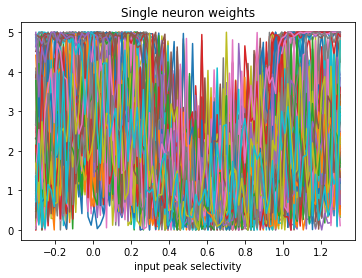

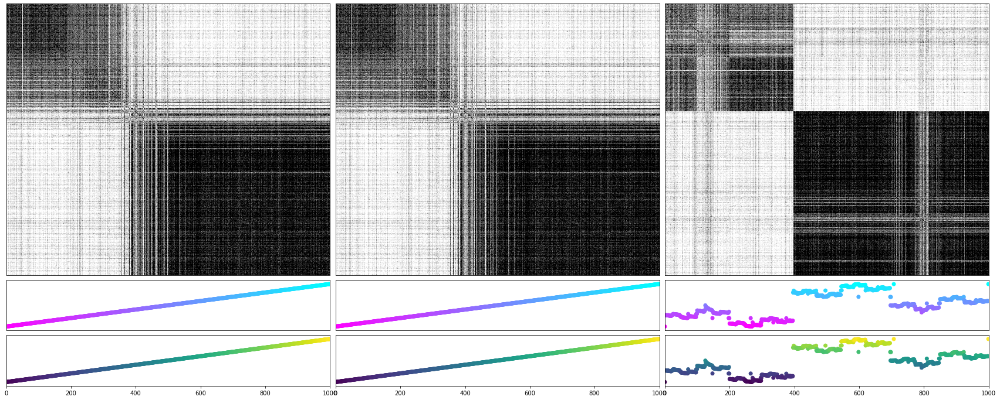

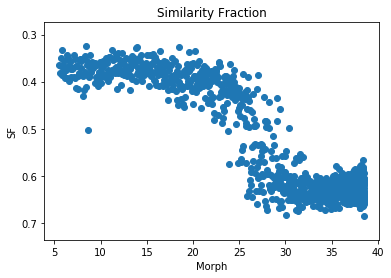

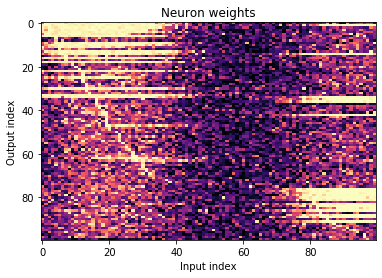

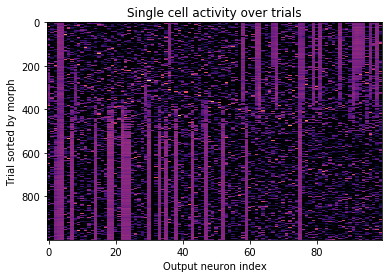

...

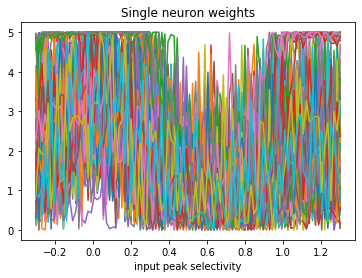

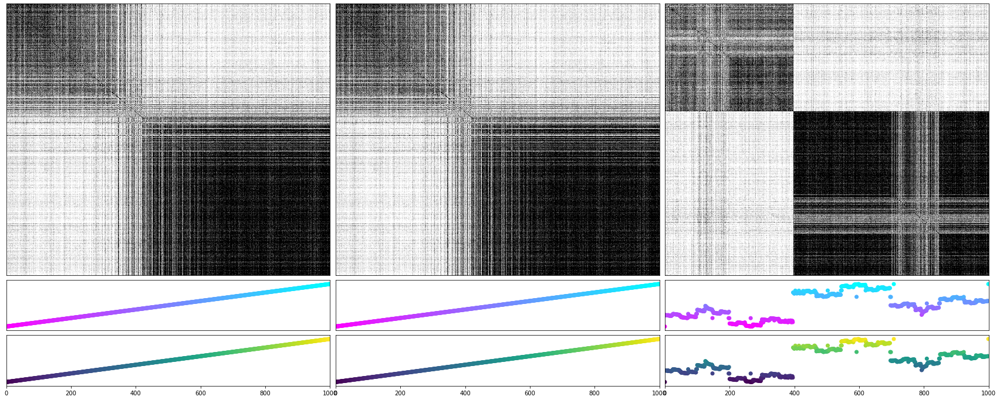

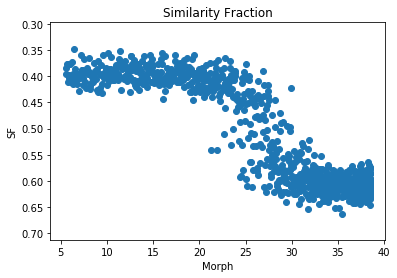

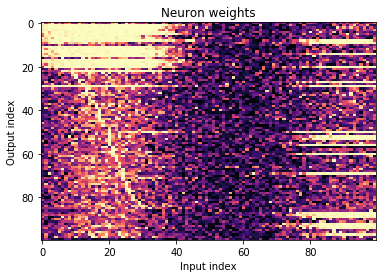

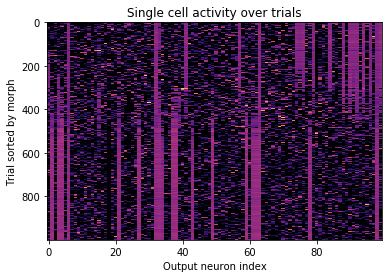

In [10]:
n_models=50
SS_rare,SF_rare = loop_model_instances(rare_spline,d_def,num=n_models,savepath="D:\\Morph_Results\\figures\\KWTA\\rare\\")

0
23.048639530565403
13.647483009397469
8.557832290517723
5.616603101578642
5.31706021321091
5.235325484821002
5.06875268943193
5.044219714742345
25.142076127426865
17.959701221797374
9.366025848522787
4.3114194021256775
4.570006958705091
4.455873297318169
4.102800515865721
3.837945917079205
21.938081278778636
14.81267421051654
10.240039313321208
8.154819345509395
5.219813400285375
4.861089696115842
4.615477117951059
4.322119843057121
18.539259567067848
12.346345922299665
7.558164195280366
7.072791823568301
6.637142163806573
4.724267475804594
4.77137420431309
4.4433002963314685


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\repos\PlittGiocomo_CA1Morph_2019\SimilarityMatrixAnalysis.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=[30,12])


16.81616485306365
12.53016227677653
9.487748174198163
4.138804344791193
3.8557681307254525
3.707064083793763
2.9863103881820168
2.8396055337322905


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

22.360970166177655
14.792158576065525
8.973192566200524
4.670317427027699
4.09845016440004
3.7241199775135923
3.654240711852431
3.5521089477487306


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

22.558496296542124
10.68452913127894
6.490737432070355
5.341291681690069
4.954132302352413
4.416406253770663
2.9726374797452304
2.793410967738275


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

22.537775768969603
14.393555828031237
10.85936956083312
5.421364359418076
5.122693077933869
4.823200344165443
4.13138045527573
3.9934064852364366


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

23.08366352058644
18.994684398638412
11.707852787865875
7.883382199219019
4.387950756454019
4.446327471265408
3.5050247700558037
4.0747875450031685


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

21.77856528040233
14.595080821072528
10.21328450214924
5.25649308395741
4.990322165725231
4.9415819342141445
4.413234285175486
4.171473584531548


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

10


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\repos\PlittGiocomo_CA1Morph_2019\SimilarityMatrixAnalysis.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=[30,12])


21.663895735926992
16.649834415017114
12.768143117520015
4.834205142072917
4.39831535642212
4.306602599818176
4.205301837924419
3.7011264520970197


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

20
30
40


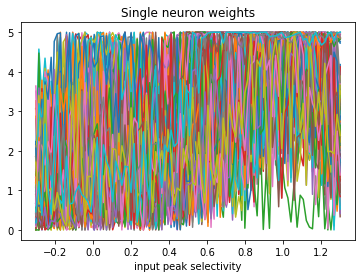

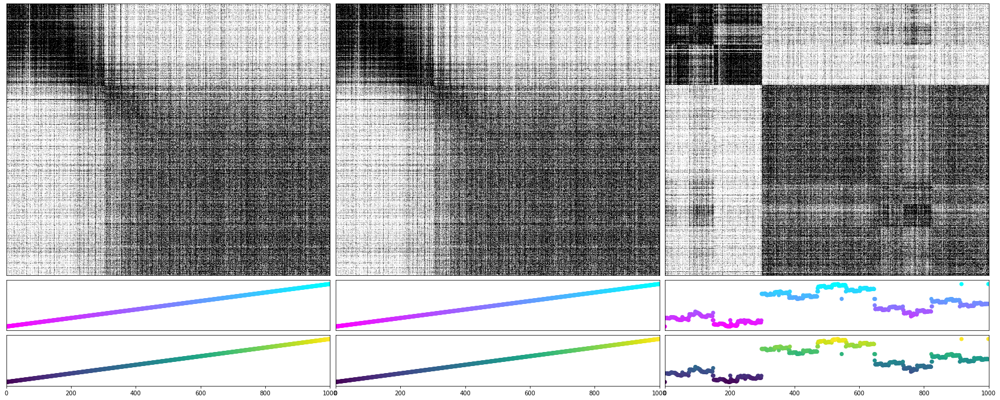

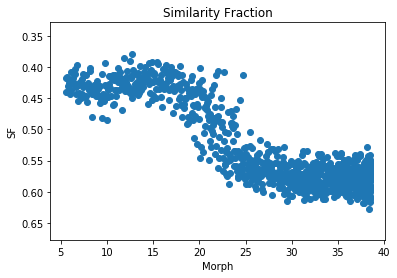

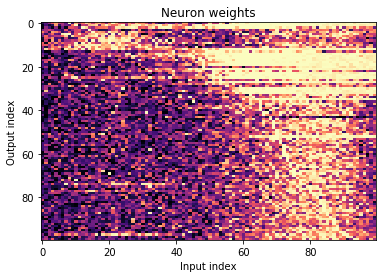

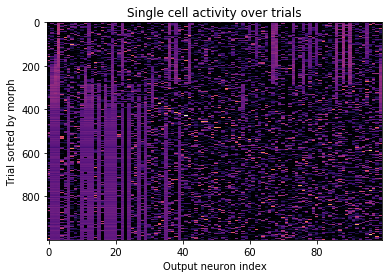

...

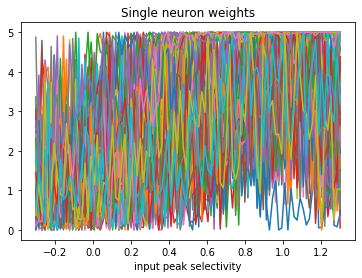

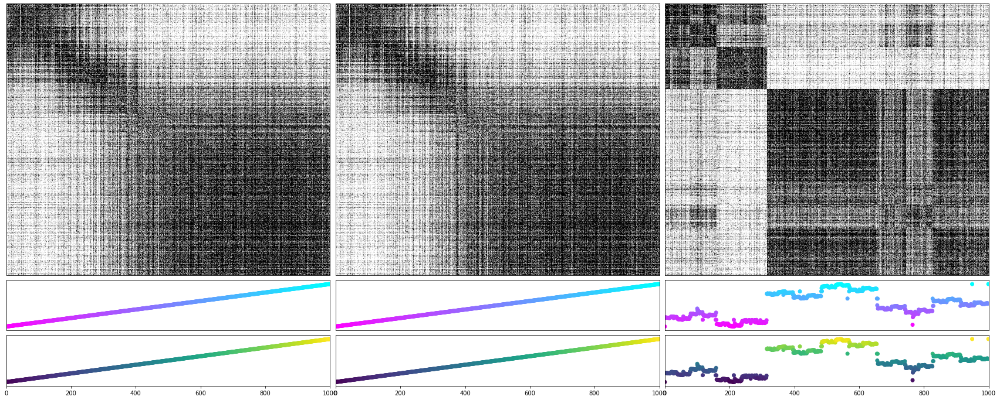

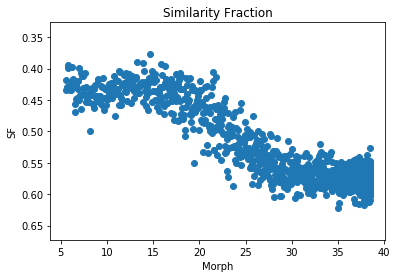

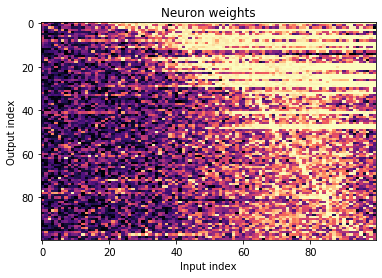

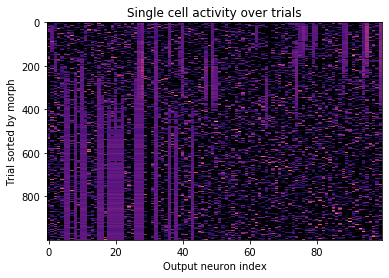

In [11]:
SS_freq,SF_freq = loop_model_instances(freq_spline,d_def,num=n_models,savepath="D:\\Morph_Results\\figures\\KWTA\\freq\\")

In [12]:
print(SS_freq.shape,SF_freq.shape)
SS_freq_norm = np.zeros(SS_freq.shape)
SS_rare_norm = np.zeros(SS_rare.shape)
for it in range(SS_freq.shape[0]):
    freqtmp = np.copy(SS_freq[it,:,:])
    freqtmp[np.diag_indices_from(freqtmp)]=np.nan
    SS_freq_norm[it,:,:] = (freqtmp-np.nanmean(freqtmp))/np.nanstd(freqtmp)
    
    raretmp = np.copy(SS_rare[it,:,:])
    raretmp[np.diag_indices_from(raretmp)]=np.nan
    SS_rare_norm[it,:,:] = (raretmp-np.nanmean(raretmp))/np.nanstd(raretmp)
    
    

(50, 1000, 1000) (50, 1000, 1)


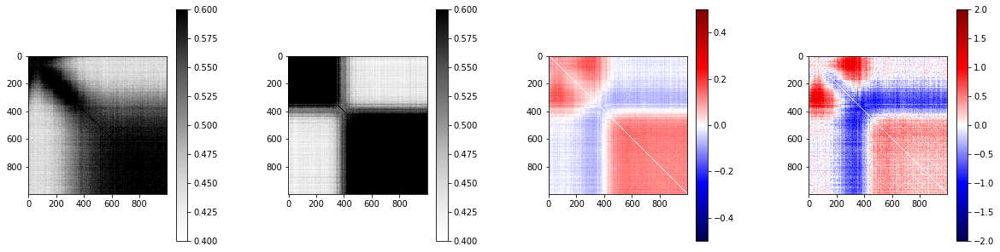

In [13]:
f,ax = plt.subplots(1,4,figsize=[20,5])
f.subplots_adjust(wspace=.5)
im = ax[0].imshow(SS_freq.mean(axis=0),cmap='Greys',vmin=0.4,vmax=.6)
f.colorbar(im,ax=ax[0])
im = ax[1].imshow(SS_rare.mean(axis=0),cmap='Greys',vmin=.4,vmax=.6)
f.colorbar(im,ax=ax[1])
im=ax[2].imshow(SS_rare.mean(axis=0)-SS_freq.mean(axis=0),cmap='seismic',vmin=-.5,vmax=.5)
f.colorbar(im,ax=ax[2])
im=ax[3].imshow(SS_rare_norm.mean(axis=0)-SS_freq_norm.mean(axis=0),cmap='seismic',vmin=-2.,vmax=2.)
f.colorbar(im,ax=ax[3])
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\avgSM.pdf",format="pdf")

In [15]:
morph_theta = np.linspace(-.3,1.3,num=1000)


x = np.linspace(-.3,1.3,num=1000)
xmask = (x>=-.1) & (x<=1.1)
mask0 = (x>=-.1) & (x<=.1)
mask1 = (x>=.9) & (x<=1.1)
HH_rare = 0
HH_freq = 0
wmsm = u.gaussian(ut.wallmorphx(morph_theta[:,np.newaxis,np.newaxis]),.1,x[np.newaxis,:,np.newaxis])
rare_H,rare_H_prior = [],[]
freq_H,freq_H_prior = [],[]
for it in range(SF_rare.shape[0]): 
    print(it)
    sf = SF_rare[it,:]
    yhat = (sf- np.median(sf[mask0]))/(np.median(sf[mask1])-np.median(sf[mask0]))*(1.073-.094) +.094 #(38.051-10.537) + 10.537 #
    yhsm = u.gaussian(yhat.reshape(-1,1,1),.1,x[np.newaxis,np.newaxis,:])# +1E-10
    H = np.sum(wmsm*yhsm,axis=0)
    Z=H.sum(axis=1)
    H/=H.sum(axis=1,keepdims=True)
    
    H_prior =H.sum(axis=0)/(u.gaussian(x[np.newaxis,:],.3,x[:,np.newaxis])/Z[:,np.newaxis]).sum(axis=1)
    H_prior /=H_prior.sum()
    
    rare_H.append(H)
    rare_H_prior.append(H_prior)
    
    HH_rare += H
    
    
    sf = SF_freq[it,:]
    yhat = (sf- np.median(sf[mask0]))/(np.median(sf[mask1])-np.median(sf[mask0]))*(1.073-.094) +.094 #(38.051-10.537) + 10.537 #
    yhsm = u.gaussian(yhat.reshape(-1,1,1),.1,x[np.newaxis,np.newaxis,:])# +1E-10
    H = np.sum(wmsm*yhsm,axis=0)
    Z=H.sum(axis=1)
    H/=H.sum(axis=1,keepdims=True)
    H_prior =H[:,:].sum(axis=0)/(u.gaussian(x[np.newaxis,:],.3,x[:,np.newaxis])/Z[:,np.newaxis]).sum(axis=1)
    H_prior /=H_prior.sum()
    
    freq_H.append(H)
    freq_H_prior.append(H_prior)
    
    HH_freq += H
    
HH_rare /=HH_rare.sum(axis=1,keepdims=True)
HH_freq /=HH_freq.sum(axis=1,keepdims=True)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


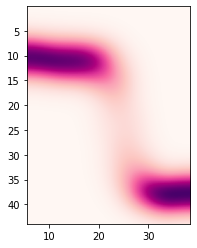

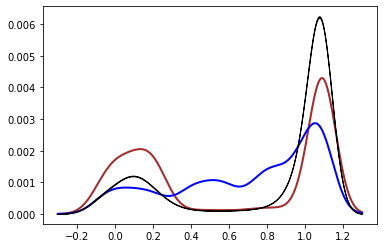

In [16]:
f,ax = plt.subplots()
xmask = (x>=-.1) & (x<=1.1)
ax.imshow(HH_rare[xmask,:].T,cmap='RdPu',extent=[ut.inv_wallmorphx(-.1),ut.inv_wallmorphx(1.1),ut.inv_wallmorphx(1.3),ut.inv_wallmorphx(-.3)])
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\rare_avgpost.pdf",format="pdf")


f,ax = plt.subplots()
rare_H_prior = np.array(rare_H_prior)
mu,sem = rare_H_prior.mean(axis=0),sp.stats.sem(rare_H_prior,axis=0)
ax.fill_between(x,mu+sem,mu-sem,color='black',alpha=1,zorder=1)
ax.plot(x,rare_prior.ravel(),color='brown',linewidth=2,zorder=-1)
ax.plot(x,freq_prior.ravel(),color='blue',linewidth=2,zorder=-1)
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\rare_avgrare.pdf",format="pdf")

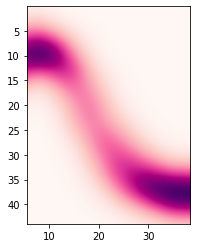

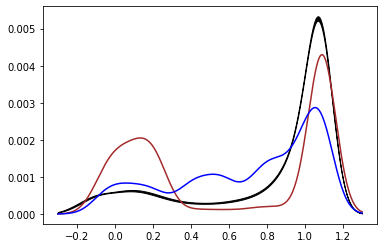

In [17]:
f,ax = plt.subplots()
xmask = (x>=-.1) & (x<=1.1)
ax.imshow(HH_freq[xmask,:].T,cmap='RdPu',extent=[ut.inv_wallmorphx(-.1),ut.inv_wallmorphx(1.1),ut.inv_wallmorphx(1.3),ut.inv_wallmorphx(-.3)])
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\freq_avgpost.pdf",format="pdf")

f,ax = plt.subplots()
freq_H_prior = np.array(freq_H_prior)
mu,sem = freq_H_prior.mean(axis=0),sp.stats.sem(freq_H_prior,axis=0)
ax.fill_between(x,mu+sem,mu-sem,color='black',alpha=1)
ax.plot(x,rare_prior.ravel(),color='brown')
ax.plot(x,freq_prior.ravel(),color='blue')
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\freq_avgrare.pdf",format="pdf")

In [18]:

def calc_kldivs(H_list):
    kldivs=[]
    for H in H_list:
        rare_kl,freq_kl = [],[]
        for row in range(H.shape[1]):
            if (x[row]>=.1) and (x[row]<=1.1):
                rare_kl.append(sp.stats.entropy(rare_post[row,:],H[row,:],base=2))
                freq_kl.append(sp.stats.entropy(freq_post[row,:],H[row,:],base=2))
        kldivs.append(np.array(rare_kl).mean()-np.array(freq_kl).mean())
    return kldivs
rare_kldivs,freq_kldivs = calc_kldivs(rare_H), calc_kldivs(freq_H)

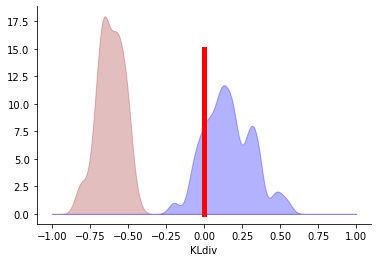

In [26]:
rare_kldivs_sm = u.gaussian(np.array(rare_kldivs)[:,np.newaxis],.05,np.linspace(-1.,1.,num=1000)[np.newaxis,:]).sum(axis=0)
freq_kldivs_sm = u.gaussian(np.array(freq_kldivs)[:,np.newaxis],.05,np.linspace(-1.,1,num=1000)[np.newaxis,:]).sum(axis=0)
f,ax = plt.subplots()
ax.fill_between(np.linspace(-1,1,num=1000),rare_kldivs_sm,color='brown',alpha=.3)
ax.fill_between(np.linspace(-1,1,num=1000),freq_kldivs_sm,color='blue',alpha=.3)
ax.plot([0,0],[0,15],color='red',linewidth=5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.set_xlabel('KLdiv')
f.savefig("D:\\Morph_Results\\figures\\KWTA\\kldiv_hist.pdf",format="pdf")


-0.34582385751704126 0.09974584253850725


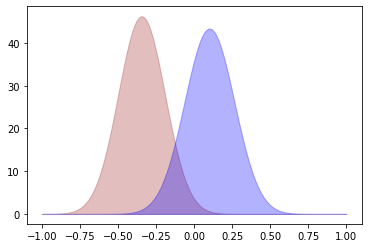

In [27]:
rare_prior_kldivs=[]
freq_prior_kldivs=[]
for it in range(rare_H_prior.shape[0]):
    rare_prior_kldivs.append(sp.stats.entropy(rare_prior.ravel(),rare_H_prior[it,:].ravel())-sp.stats.entropy(freq_prior.ravel(),rare_H_prior[it,:].ravel()) )
    freq_prior_kldivs.append(sp.stats.entropy(rare_prior.ravel(),freq_H_prior[it,:].ravel())-sp.stats.entropy(freq_prior.ravel(),freq_H_prior[it,:].ravel()) )

print(np.array(rare_prior_kldivs).mean(),np.array(freq_prior_kldivs).mean())
rare_prior_kldivs_sm = u.gaussian(np.array(rare_prior_kldivs)[:,np.newaxis],.20,np.linspace(-1,1,num=1000)[np.newaxis,:]).sum(axis=0)
freq_prior_kldivs_sm = u.gaussian(np.array(freq_prior_kldivs)[:,np.newaxis],.20,np.linspace(-1,1,num=1000)[np.newaxis,:]).sum(axis=0)
f,ax = plt.subplots()
ax.fill_between(np.linspace(-1,1,num=1000),rare_prior_kldivs_sm,color='brown',alpha=.3)
ax.fill_between(np.linspace(-1,1,num=1000),freq_prior_kldivs_sm,color='blue',alpha=.3)

NameError: name 'kldivs' is not defined

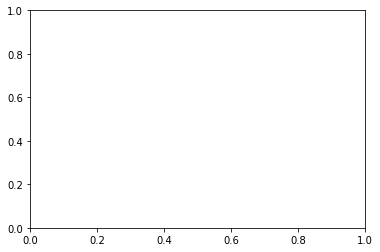

In [21]:
f,ax= plt.subplots()
ax.hist(kldivs)

In [32]:
print(ut.inv_wallmorphx(.4)-ut.inv_wallmorphx(.1))

8.226206354721889


In [33]:
.3/1.2

0.25